In [1]:
# import jax
# import jax.numpy as jnp

# print(jax.devices())  # Should list GPU(s)
# x = jnp.array([1, 2, 3])
# print(x.device())  # Should print "gpu:0"

In [1]:
import scvi
scvi.settings.seed = 42
from celldisect import CellDISECT
import torch
#from lightning.pytorch.loggers import WandbLogger
import os
import shutil
import scanpy as sc


torch.set_float32_matmul_precision('medium')
import warnings
warnings.simplefilter("ignore", UserWarning)





Global seed set to 0
Global seed set to 42


In [15]:
sc.settings.verbosity=0 # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.n_jobs=4
sc.settings.set_figure_params(dpi_save=300, facecolor="white", frameon=False, figsize=(12,12))


import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42


# Load adata

In [4]:
# !ls -lshatr /nfs/team298/ls34/new_disease_atlas/ | grep -i dis2p

In [2]:
BASE_DIR = '/nfs/team298/ls34/new_disease_atlas/'
MODEL='FB_DIS2P_datasetidHEALTHY10000'
MODEL_NAME = os.listdir(BASE_DIR+MODEL)[0]
PATH=BASE_DIR + MODEL + '/'+ MODEL_NAME + '/'
os.listdir(PATH)

['adata_processed.h5ad', 'adata.h5ad', 'model.pt']

In [5]:
# adata = sc.read_h5ad(PATH + "adata_processed.h5ad") # Write the path to your h5ad file
# adata
adata=sc.read_h5ad('/nfs/team298/ls34/fibroblast_atlas_paper/final_adatas_chloecolours/adata_postdis2p.h5ad')
adata
#adata_lesional.obs["lvl3_annotation_pred"].value_counts())

AnnData object with n_obs × n_vars = 85820 × 36601
    obs: 'sample_id', 'barcode', 'dataset_id', 'GSE', 'Site_status', 'Patient_status', 'DonorID', 'Location', 'Age', 'Sex', 'n_genes', 'OriginalAnnotation', 'Chemistry', 'lvl3_annotation', 'lvl2_annotation', 'lvl1_annotation', 'lvl0_annotation', 'n_genes_by_counts', 'total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'QC_hi', 'QC_mid', 'leiden_res0.2', 'Site_status_binary', 'atlas_status_reynolds', 'atlas_status', 'Site_status2', 'Patient_status2', 'Sex_original', 'fb_vs_other', 'fb_vs_other2', 'core', 'fbs_pericytes_other', 'leiden_res1', 'leiden_res1.5', 'old_annotation', 'test', 'fbs', 'fbs2', 'fbs3', 'new_annotation3', 'new_annotation2', 'new_annotation1', 'new_annotation00', 'fb_status_figs', 'Location_original', 'Location_broad', 'Location_detailed', 'leiden_res0.5', 't

In [7]:
# adata.write('/nfs/team298/ls34/fibroblast_atlas_paper/final_adatas_chloecolours/adata_postdis2p.h5ad')
# adata
# #adata_lesional.obs["lvl3_annotation_pred"].value_counts())

AnnData object with n_obs × n_vars = 85820 × 36601
    obs: 'sample_id', 'barcode', 'dataset_id', 'GSE', 'Site_status', 'Patient_status', 'DonorID', 'Location', 'Age', 'Sex', 'n_genes', 'OriginalAnnotation', 'Chemistry', 'lvl3_annotation', 'lvl2_annotation', 'lvl1_annotation', 'lvl0_annotation', 'n_genes_by_counts', 'total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'QC_hi', 'QC_mid', 'leiden_res0.2', 'Site_status_binary', 'atlas_status_reynolds', 'atlas_status', 'Site_status2', 'Patient_status2', 'Sex_original', 'fb_vs_other', 'fb_vs_other2', 'core', 'fbs_pericytes_other', 'leiden_res1', 'leiden_res1.5', 'old_annotation', 'test', 'fbs', 'fbs2', 'fbs3', 'new_annotation3', 'new_annotation2', 'new_annotation1', 'new_annotation00', 'fb_status_figs', 'Location_original', 'Location_broad', 'Location_detailed', 'leiden_res0.5', 't

In [6]:
cats = [#'DonorID', 
       'Location', "dataset_id", 'corefb_names2',# 'Sex'
]  


In [7]:
# cell_type_included = True # Set to True if you have provided a cell type annotation in the cats list

# module_name = 'FB_DIS2P'
# pre_path = f'/nfs/team298/ls34/new_disease_atlas/{module_name}'
# if not os.path.exists(pre_path):
#     os.makedirs(pre_path)


In [8]:
# arch_dict = {'n_layers': 2,
#  'n_hidden': 128,
#  'n_latent_shared': 32,
#  'n_latent_attribute': 32,
#  'dropout_rate': 0.1,
#  'weighted_classifier': False,
# }
# train_dict = {
#  'max_epochs': 50,
#  'batch_size': 256,
#  'recon_weight': 20,
#  'cf_weight': 0.8,
#  'beta': 0.003,
#  'clf_weight': 0.05,
#  'adv_clf_weight': 0.014,
#  'adv_period': 5,
#  'n_cf': 1,
#  'early_stopping_patience': 6,
#  'early_stopping': True,
#  'save_best': True,
#  'kappa_optimizer2': False,
#  'n_epochs_pretrain_ae': 0,
# }

# plan_kwargs = {
#  'lr': 0.003,
#  'weight_decay': 0.00005,
#  'ensemble_method_cf': True,
#  'lr_patience': 5,
#  'lr_factor': 0.5,
#  'lr_scheduler_metric': 'loss_validation',
#  'n_epochs_kl_warmup': 10,
# }
# # specify a name for your model
# model_name = (
#     f'pretrainAE_{train_dict["n_epochs_pretrain_ae"]}_'
#     f'maxEpochs_{train_dict["max_epochs"]}_'
#     f'reconW_{train_dict["recon_weight"]}_'
#     f'cfWeight_{train_dict["cf_weight"]}_'
#     f'beta_{train_dict["beta"]}_'
#     f'clf_{train_dict["clf_weight"]}_'
#     f'adv_{train_dict["adv_clf_weight"]}_'
#     f'advp_{train_dict["adv_period"]}_'
#     f'n_cf_{train_dict["n_cf"]}_'
#     f'lr_{plan_kwargs["lr"]}_'
#     f'wd_{plan_kwargs["weight_decay"]}_'
#     f'ensemble_cf_{plan_kwargs["ensemble_method_cf"]}_'
#     f'dropout_{arch_dict["dropout_rate"]}_'
#     f'n_hidden_{arch_dict["n_hidden"]}_'
#     f'n_latent_{arch_dict["n_latent_shared"]}_'
#     f'n_layers_{arch_dict["n_layers"]}_'
#     f'batch_size_{train_dict["batch_size"]}_'
# )
# if cell_type_included:
#     model_name = model_name + f'cellTypeIncluded'
# else:
#     model_name = model_name + f'cellTypeNotIncluded'


# Analysis

In [16]:
adata

AnnData object with n_obs × n_vars = 85820 × 36601
    obs: 'sample_id', 'barcode', 'dataset_id', 'GSE', 'Site_status', 'Patient_status', 'DonorID', 'Location', 'Age', 'Sex', 'n_genes', 'OriginalAnnotation', 'Chemistry', 'lvl3_annotation', 'lvl2_annotation', 'lvl1_annotation', 'lvl0_annotation', 'n_genes_by_counts', 'total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'QC_hi', 'QC_mid', 'leiden_res0.2', 'Site_status_binary', 'atlas_status_reynolds', 'atlas_status', 'Site_status2', 'Patient_status2', 'Sex_original', 'fb_vs_other', 'fb_vs_other2', 'core', 'fbs_pericytes_other', 'leiden_res1', 'leiden_res1.5', 'old_annotation', 'test', 'fbs', 'fbs2', 'fbs3', 'new_annotation3', 'new_annotation2', 'new_annotation1', 'new_annotation00', 'fb_status_figs', 'Location_original', 'Location_broad', 'Location_detailed', 'leiden_res0.5', 't

In [29]:
# adata.obsm[f'dis2p_Z_0'] = model.get_latent_representation(nullify_cat_covs_indices=[s for s in range(len(cats))], nullify_shared=False)

# for i in range(len(cats)):
#     null_idx = [s for s in range(len(cats)) if s != i]
#     # Z_i
#     adata.obsm[f'dis2p_Z_{i+1}'] = model.get_latent_representation(nullify_cat_covs_indices=null_idx, nullify_shared=True)
#     # Z_{-i}
#     adata.obsm[f'dis2p_Z_not_{i+1}'] = model.get_latent_representation(nullify_cat_covs_indices=[i], nullify_shared=False)

---UMAP for dis2p_Z_0---


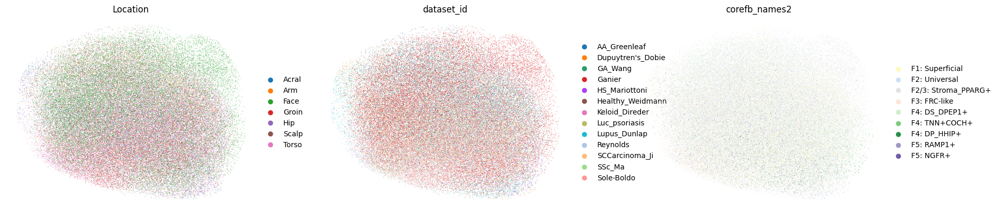

---UMAP for dis2p_Z_1---


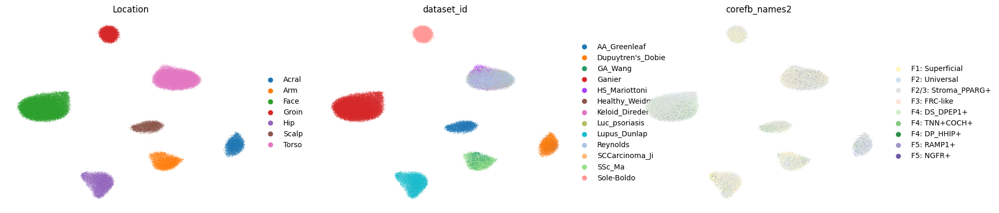

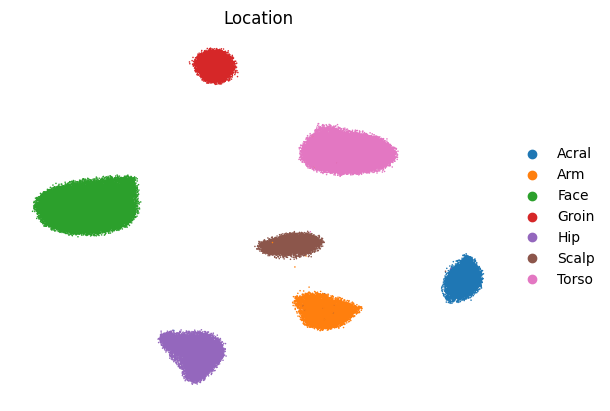

---UMAP for dis2p_Z_2---


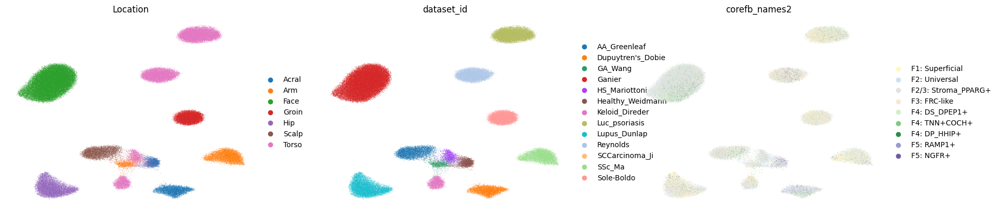

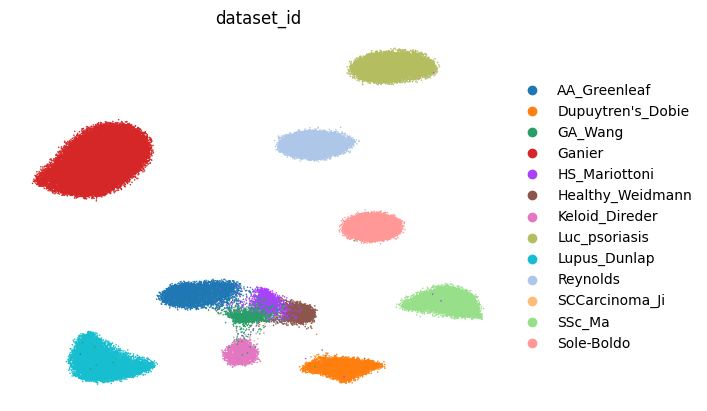

---UMAP for dis2p_Z_3---


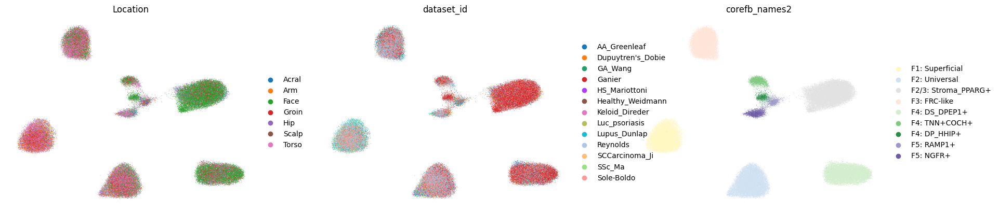

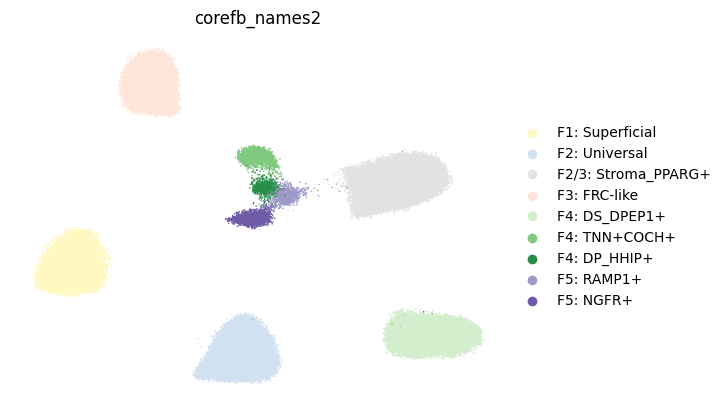

In [17]:
#cats = ['Age', 'Sex', 'lvl1_annotation', 'Location_broad', "DonorID"] 

for i in range(len(cats)+1):  # loop over all Z_i

    latent_name = f'dis2p_Z_{i}'

    print(f"---UMAP for {latent_name}---")

    sc.pp.neighbors(adata, use_rep=f"{latent_name}", 
                   n_neighbors=20)
    sc.tl.umap(adata)

    sc.pl.umap(
        adata,
        color=cats,
        ncols=len(cats),
        frameon=False,
    )
    if i !=0:
        sc.pl.umap(
            adata,
            color=cats[i-1],
           # ncols=len(cats),
            frameon=False,
            s=5,
        )

In [8]:
latent_name = f'dis2p_Z_1'


print(f"---UMAP for {latent_name}---")

sc.pp.neighbors(adata, use_rep=f"{latent_name}",  n_neighbors=20)
sc.tl.umap(adata)



---UMAP for dis2p_Z_1---


In [11]:
CMAP = {
    'F1: Superficial': '#ffef5a',
    'F2/3: Perivascular': '#364f99',
        'F2/3: Stroma_PPARG+': '#364f99',

    'F2: Universal': '#91bae2',
    'F3: FRC-like': '#c6508f',
    'F4: DP_HHIP+': '#c9efb4',
    'F4: DS_DPEP1+': '#3d6f3b',
    'F4: TNN+COCH+': '#00f273',
    'F5: NGFR+': '#8981a7',
    'F5: RAMP1+': '#4b2657'
}

cmap_core = {
    'F1: Superficial\n(Papillary)': '#ffef5a',
    'F2/3:\nPerivascular': '#364f99',
    'F2: Universal\n(Reticular)': '#91bae2',
    'F3: FRC-like': '#c6508f',
    'F4: DP_HHIP+': '#c9efb4',
    'F4: DS_DPEP1+': '#3d6f3b',
    'F4: TNN+COCH+': '#00f273',
   'F5: Schwann-like\nNGFR+': '#8981a7',
    'F5: Schwann-like\nRAMP1+': '#4b2657'
}


adata.obs['corefb_names2'] = adata.obs['corefb_names2'].astype('category')
adata.uns['corefb_names2_colors'] = [CMAP[cat] for cat in adata.obs['corefb_names2'].cat.categories]

# sc.pl.umap(
#         adata_core,
#         color=["corefb_names"],
#         ncols=1, s=20,
#     legend_loc="on data", legend_fontoutline=2, 
#            legend_fontweight="normal", legend_fontsize=18, title='',
#         frameon=False,
#      #save="fig1umap.pdf"
    
#     )

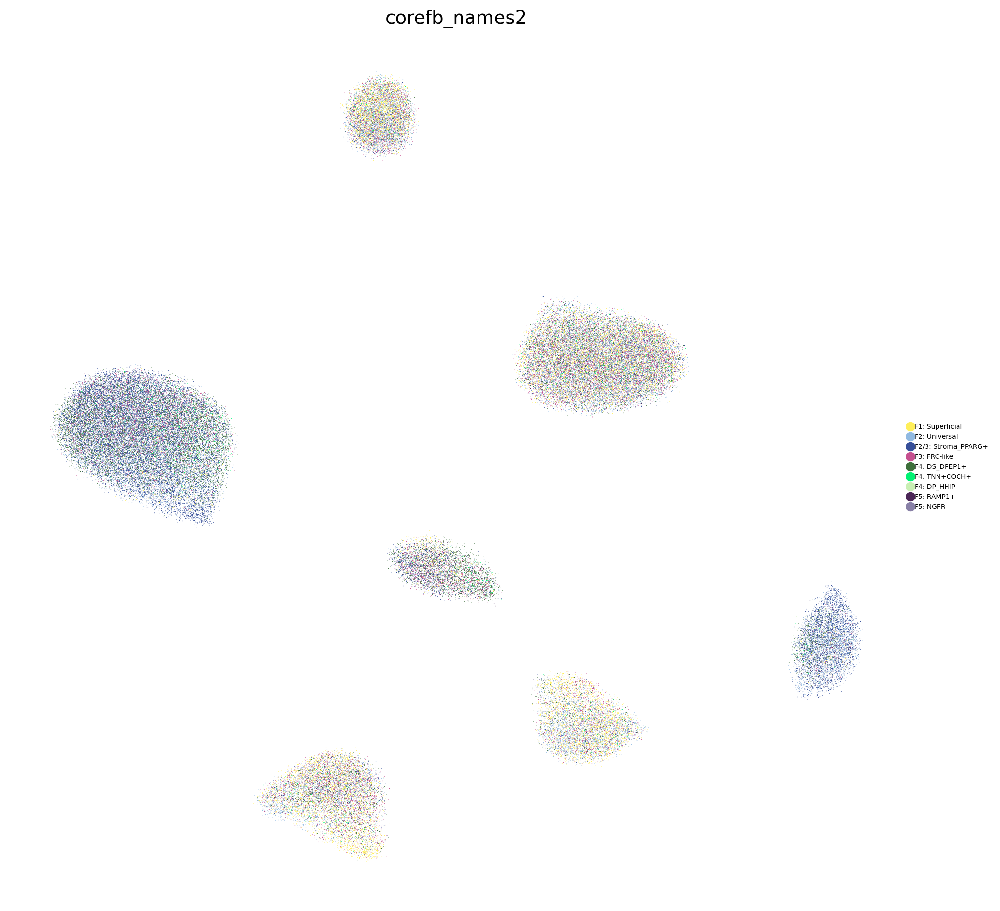

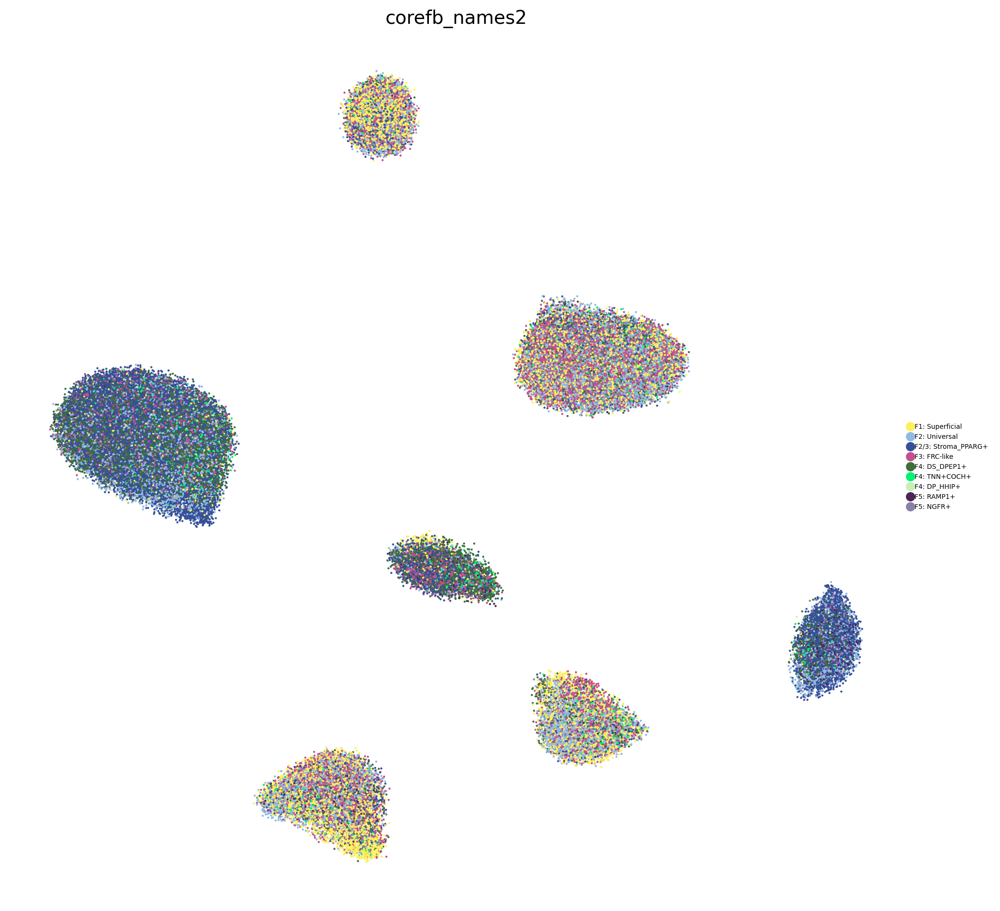

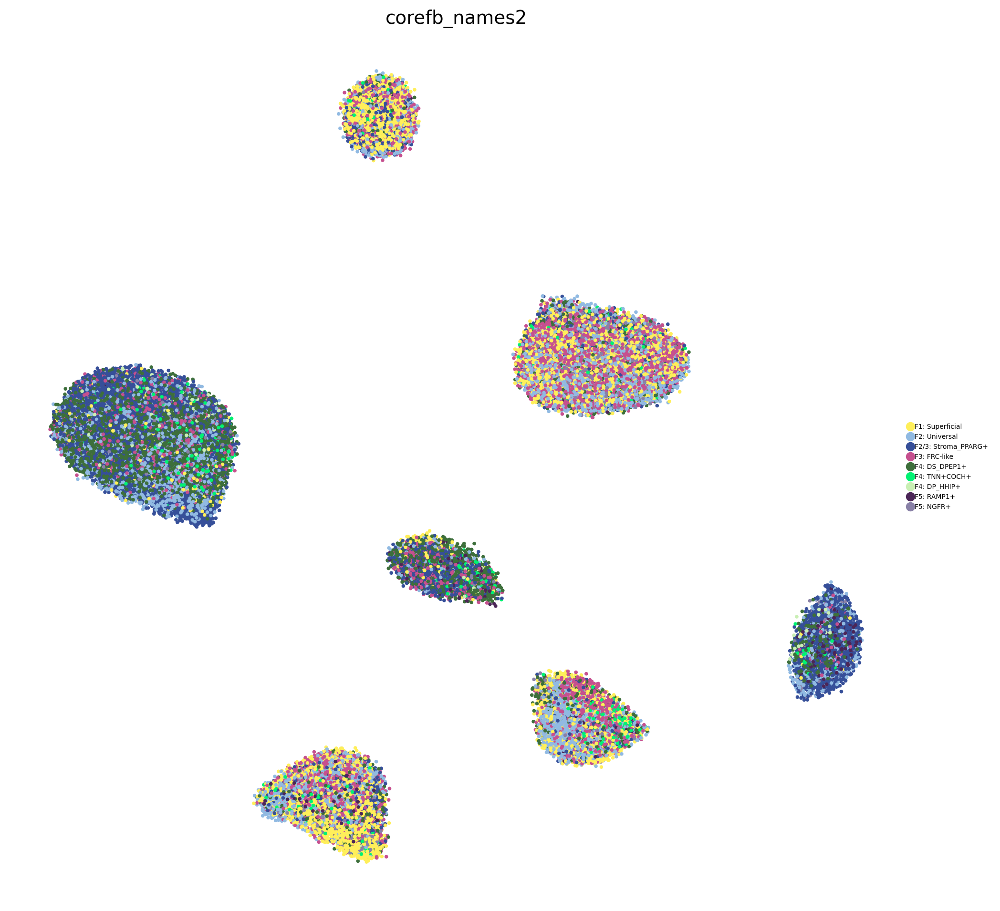

In [12]:
sc.pl.umap(
    adata,
    color="corefb_names2",
    #ncols=len(cats),
    frameon=False,
    #legend_loc="on data", 
    legend_fontsize=5,
    s=1)
sc.pl.umap(
    adata,
    color="corefb_names2",
    #ncols=len(cats),
    frameon=False,
    #legend_loc="on data", 
    legend_fontsize=5,
    s=10)
sc.pl.umap(
    adata,
    color="corefb_names2",
    #ncols=len(cats),
    frameon=False,
    #legend_loc="on data", 
    legend_fontsize=5,
    s=30,
    save="supp1f
)

In [32]:
# # Define color palettes for each group
# colors_f1 = plt.cm.YlOrBr(np.linspace(0, 1, 10))
# colors_f2 = plt.cm.Blues(np.linspace(0.2, 1, 10))
# colors_f3 = plt.cm.Reds(np.linspace(0.1, 1, 10))
# colors_f4 = plt.cm.Greens(np.linspace(0.2, 1, 10))
# colors_f5 = plt.cm.Purples(np.linspace(0.5, 1.0, 10))  # Brighter purple palette
# colors_f6 = ['#f18dba']  # Specific color for F6 or similar colors
# #colors_other = plt.cm.Greys(np.linspace(0.2, 1, 10))
# colors_other = plt.cm.Greys(np.linspace(0.2, 1, 20))
# # Define the mapping based on the prefixes
# custom_colors = {}

# # Manually assign the same color to "F1*: Secretory" and "F1: Secretory superficial"
# f1_shared_color = colors_f1[0]
# colors_f1 = colors_f1[1:]

# sc.settings.set_figure_params(dpi=100, facecolor="white", frameon=False, figsize=(14, 14))


# for category in adata.obs["corefb_names"].cat.categories:
#     if category.startswith("F1"):
#         custom_colors[category] = colors_f1[0]
#         colors_f1 = colors_f1[1:]
#     elif category.startswith("F2"):
#         custom_colors[category] = colors_f2[0]
#         colors_f2 = colors_f2[1:]
#     elif category.startswith("F3") or category.startswith("Peric") or category.startswith("Vasc"):
#         custom_colors[category] = colors_f3[0]
#         colors_f3 = colors_f3[1:]
#     elif category.startswith("F4"):
#         custom_colors[category] = colors_f4[0]
#         colors_f4 = colors_f4[1:]
#     elif category.startswith("F5"):
#         custom_colors[category] = colors_f5[0]
#         colors_f5 = colors_f5[3:]
#     elif category.startswith("F6"):
#         custom_colors[category] = colors_f6[0]
#     else:
#         print("other")
#         custom_colors[category] = colors_other[0]
#         colors_other = colors_other[3:]

# # Apply the custom colors to the adata object
# adata.uns["corefb_names_colors"] = [custom_colors[cat] for cat in adata.obs["corefb_names"].cat.categories]


# sc.pl.umap(
#     adata,
#     color="corefb_names",
#     #ncols=len(cats),
#     frameon=False,
#     legend_loc="on data", legend_fontsize=5,
#     s=5)

NameError: name 'plt' is not defined

In [ ]:
# #cats = ['Age', 'Sex', 'lvl1_annotation', 'Location_broad', "DonorID"] 
# sc.settings.set_figure_params(dpi=100, facecolor="white", frameon=False, figsize=(12,12))


# for i in range(len(cats)+1):  # loop over all Z_i

#     latent_name = f'dis2p_Z_{i}'

#     print(f"---UMAP for {latent_name}---")

#     sc.pp.neighbors(adata, use_rep=f"{latent_name}")
#     sc.tl.umap(adata)

#     sc.pl.umap(
#         adata,
#         color=cats,
#         ncols=len(cats),
#         frameon=False,
#     )

In [ ]:
# sc.settings.set_figure_params(dpi=100, facecolor="white", frameon=False, figsize=(12,12))
# latent_name = f'dis2p_Z_1'


# print(f"---UMAP for {latent_name}---")

# sc.pp.neighbors(adata, use_rep=f"{latent_name}",  n_neighbors=20)
# sc.tl.umap(adata)



In [50]:

leidenres_list = [1]
leiden_to_plot = []
#neighbor_id = 'neighbor_50'
for leidenres in leidenres_list:
    print("###", leidenres)
    leiden_id = "leiden_res" + str(leidenres) # gayoso 1.2
    leiden_to_plot.append(leiden_id)
    sc.tl.leiden(adata, resolution=leidenres, key_added=leiden_id)# neighbors_key=neighbor_id)



### 1


In [ ]:
adata.obs

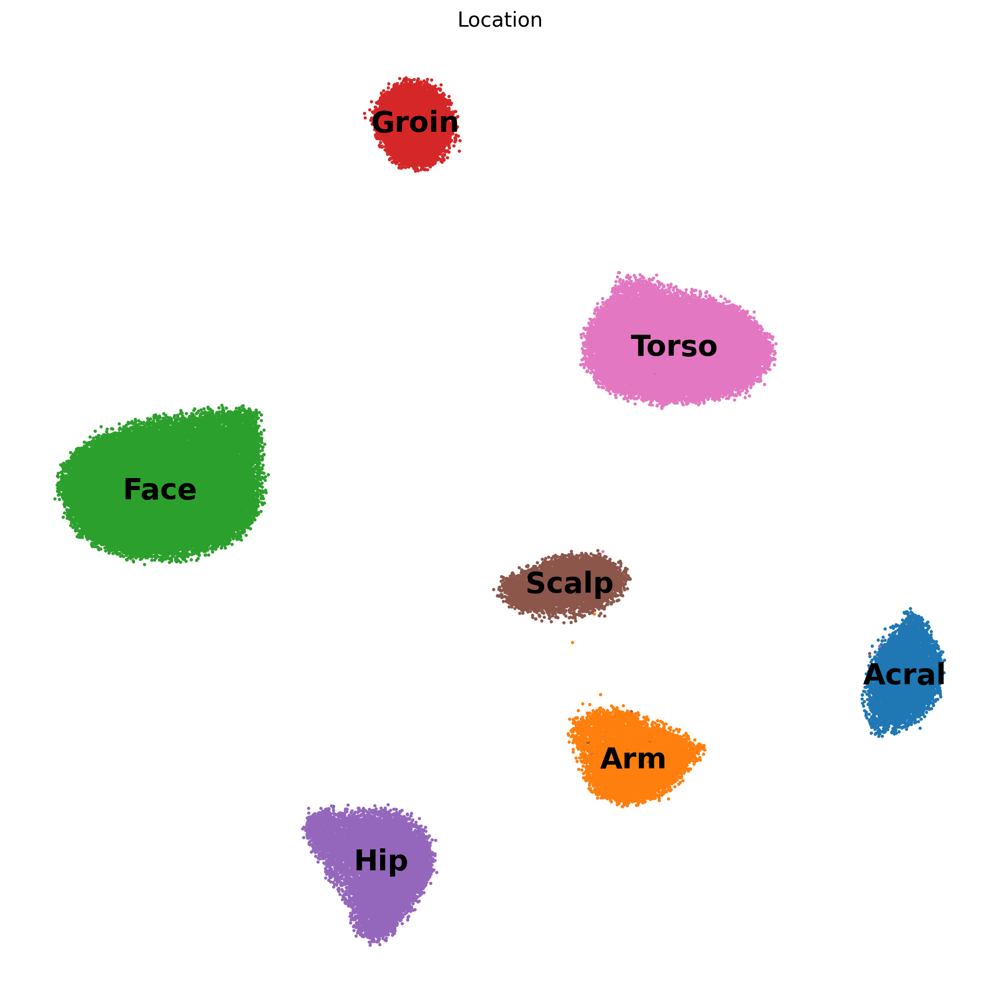

In [19]:
sc.pl.umap(
        adata,
        color=["Location"],
        ncols=len(cats), s=20,
        legend_loc="on data", legend_fontsize=20,
        frameon=False,
    )

In [27]:
adata.shape

(85820, 36601)

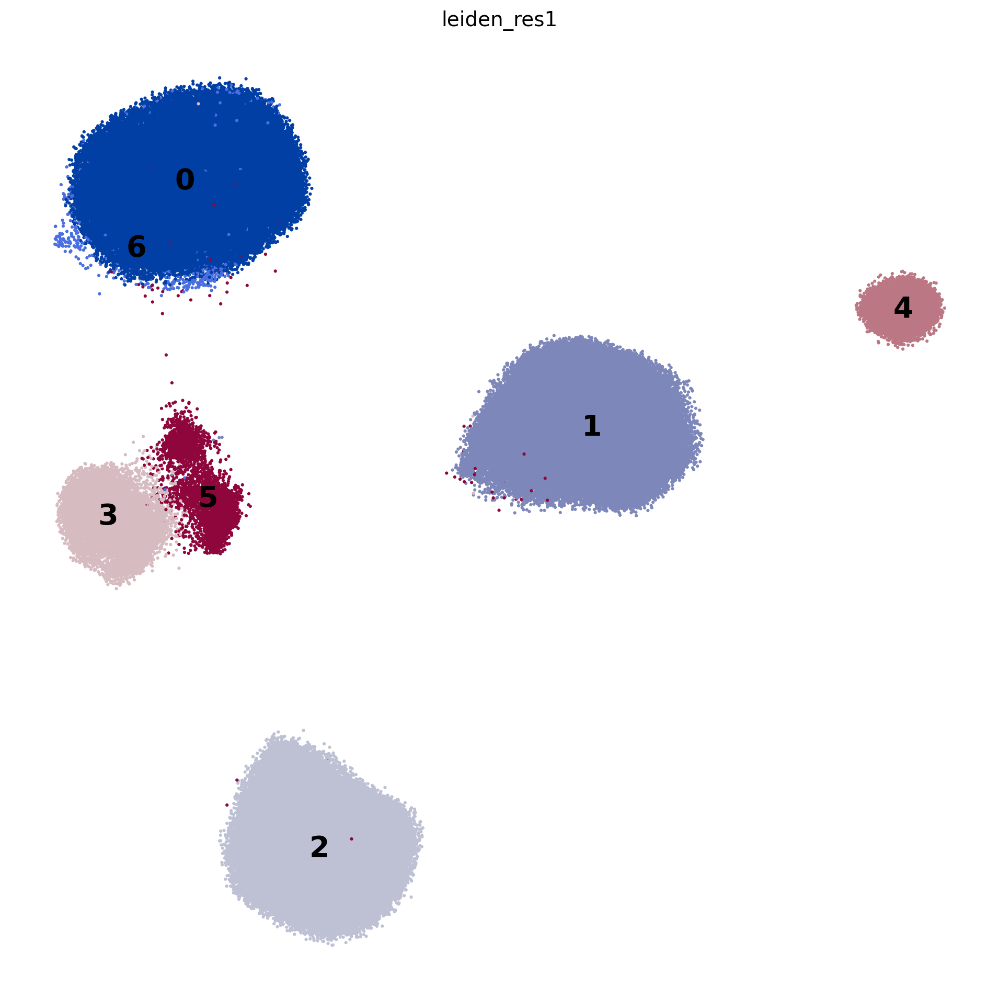

In [51]:
sc.pl.umap(
        adata,
        color=["leiden_res1",],
        ncols=len(cats), s=20,
        legend_loc="on data", legend_fontsize=20,
        frameon=False,
    )



In [52]:
{x:x for x in adata.obs["leiden_res1"]}

{'1': '1', '5': '5', '0': '0', '6': '6', '3': '3', '2': '2', '4': '4'}

In [54]:
RENAME={'1': 'Torso',
 '5': 'Acral/axilla', 
 '0': 'Limb', 
 '6': 'Limb',
 '3': 'Scalp',
 '2': 'Face', 
 '4': 'Groin'}

adata.obs["Location2"]=adata.obs["leiden_res1"].map(RENAME)

In [ ]:
RENAME = {"0":  ">70",
          "1":  "<40",
          "2": ">70",
          "3": "40-69"}
adata.obs["Age3"]=adata.obs["leiden_res0.5"].map(RENAME)

In [20]:
adata.obs["Location2"]=adata.obs["Location"]

In [21]:
import pandas as pd
#adata_subset.uns['log1p']['base'] = None
sc.tl.rank_genes_groups(adata, 'Location2', method='t-test', key_added="de_leiden");
df2 = pd.DataFrame(adata.uns['de_leiden']['names'])
df2.iloc[:, ].head(60)



,Acral,Arm,Face,Groin,Hip,Scalp,Torso
0,GSN,FP236383.3,C11orf96,B2M,FP236383.3,LINC00486,VIM
1,LAMA2,ZBTB20,MTRNR2L12,TMSB4X,LINC00486,AC105402.3,RPL30
2,AMBRA1,LINC00486,DAB2,RPS27,DHFR,FP236383.3,RPS12
3,RORA,PARD3B,HSPH1,RPL13A,LAMA2,DHFR,RPS8
4,EBF1,ROBO2,HSPD1,RPL41,ZBTB20,SIK3,RPL10
5,OOEP,KAZN,H3F3A,S100A6,RBMS3,ZFAND3,FTH1
6,RBMS3,RBMS3,HSPA1B,MALAT1,PARD3B,ZSWIM6,RPLP1
7,TXNIP,AC068587.4,HSPE1,LGALS1,KAZN,NEGR1,TPT1
8,IGFBP6,CELF2,MTRNR2L8,RPL10,CROCC,BICC1,RPS23
9,PRKG1,NAALADL2,DDX21,FTL,NAALADL2,PRKG1,RPL11


Acral


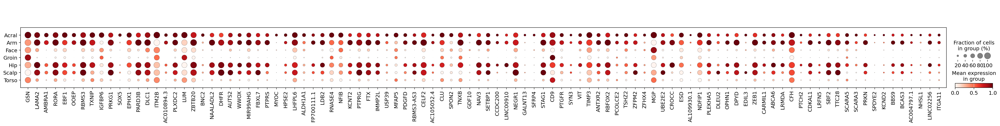

Arm


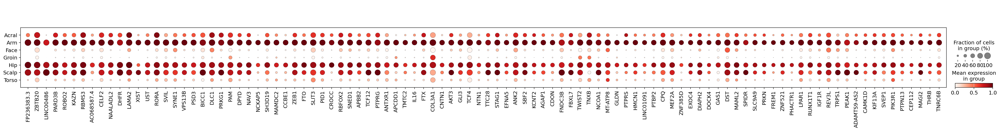

Face


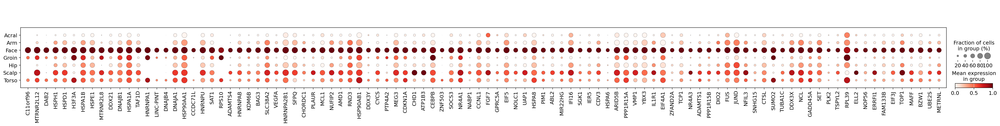

Groin


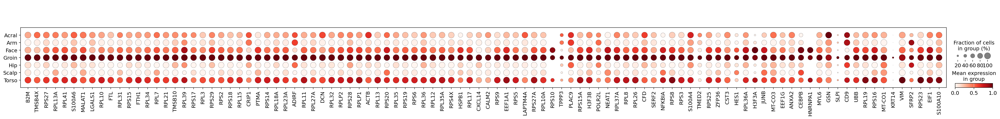

Hip


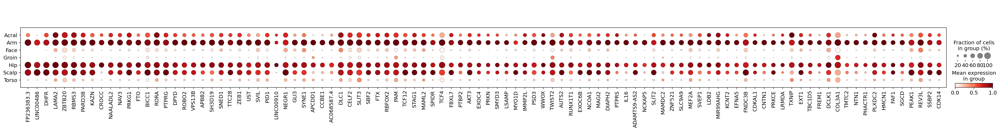

Scalp


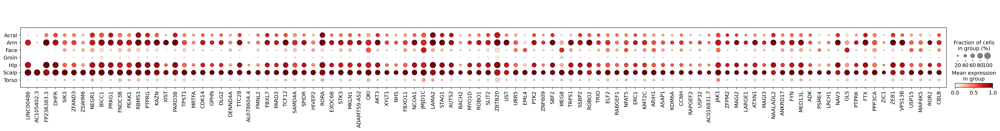

Torso


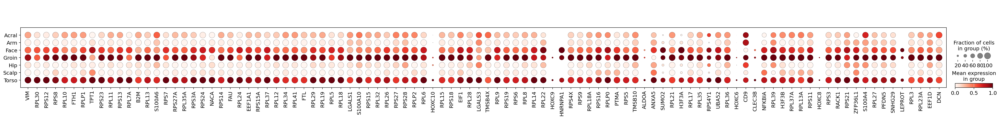

In [22]:
import pandas as pd

# Assuming you already have a DataFrame named `df`
# Here is a sample DataFrame for demonstration purposes

# Truncate the DataFrame to the first 1000 rows
df_truncated = df2.head(500)

# Initialize an empty dictionary
result_dict = {}

# Iterate over the columns of the DataFrame
for i, column in enumerate(df2.columns):
    print(column)
    select_pop = list(df2.columns)[i]
    genes0= df2[select_pop][:100]
    genes1= df2[select_pop][100:200]
    genes2= df2[select_pop][200:300]
    genes3= df2[select_pop][300:400]
    genes4= df2[select_pop][400:500]
    genes5= df2[select_pop][500:600]

    genes6= df2[select_pop][600:700]
    genes7= df2[select_pop][700:800]
    genes8= df2[select_pop][800:900]
    genes9= df2[select_pop][900:1000]
    genes10= df2[select_pop][1000:1100]
    genes11= df2[select_pop][1100:1200]
        #values = df_truncated[column][df_truncated[column].str.startswith("HOX", na=False)].tolist()
        #result_dict[column] = values

    # Display the resulting dictionary
    #print(result_dict)
    sc.pl.dotplot(
        adata,
        genes0,
        groupby="Location2",
       standard_scale="var",
        dendrogram=False,
) 
# sc.pl.dotplot(
#     adata,
#     "HOXA13",
#     groupby="test",
#    standard_scale="var",
#     dendrogram=False,
# ) 

Acral
Arm
Face
Groin
Hip
Scalp
Torso
{'Acral': ['HOXA13', 'HOXD10', 'HOXA11-AS', 'HOXD11', 'HOXA7', 'HOXD13', 'HOXA11'], 'Arm': ['HOXB3', 'HOXD10', 'HOXB-AS3', 'HOXA9', 'HOXA11', 'HOXD3', 'HOXA13', 'HOXA3'], 'Face': ['HOXD8', 'HOXD4', 'HOXD1'], 'Groin': ['HOXC9', 'HOXA10', 'HOXC8', 'HOXC6', 'HOXC10', 'HOXB6', 'HOXC-AS3', 'HOXC11', 'HOXB5', 'HOXC5', 'HOXB7', 'HOXB4', 'HOXB-AS3', 'HOXC-AS1', 'HOXB-AS1', 'HOXC-AS2', 'HOXA4', 'HOXA6', 'HOXA9', 'HOXC12', 'HOXA10-AS', 'HOXA5', 'HOXB8', 'HOXA11-AS'], 'Hip': ['HOXB3', 'HOXB-AS3', 'HOXC4', 'HOXB7', 'HOXB2', 'HOXD3'], 'Scalp': ['HOXD3', 'HOXB-AS1'], 'Torso': ['HOXC10', 'HOXC9', 'HOXC6', 'HOXC8', 'HOXA10', 'HOXB7', 'HOXB5', 'HOXC-AS1', 'HOXC11', 'HOXB6', 'HOXB4', 'HOXA9', 'HOXB-AS3', 'HOXA5', 'HOXC5', 'HOXB8', 'HOXC-AS3', 'HOXB9', 'HOXA4', 'HOXC-AS2', 'HOXA6', 'HOXB3', 'HOXA7', 'HOXC4', 'HOXA11', 'HOXB2', 'HOXA1', 'HOXC13', 'HOXA10-AS', 'HOXB1', 'HOXC12', 'HOXA3', 'HOXB-AS2', 'HOXA-AS3', 'HOXA-AS2', 'HOXA2', 'HOXB-AS4', 'HOXD4']}


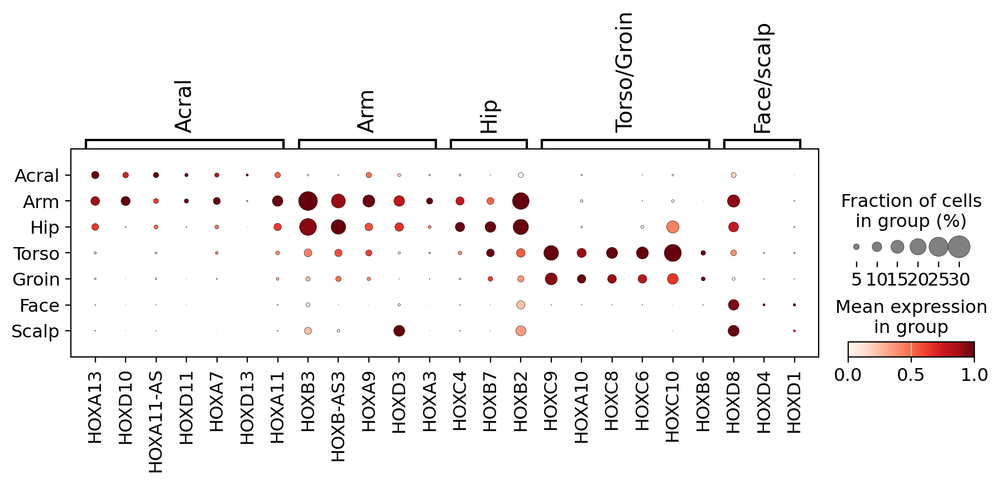

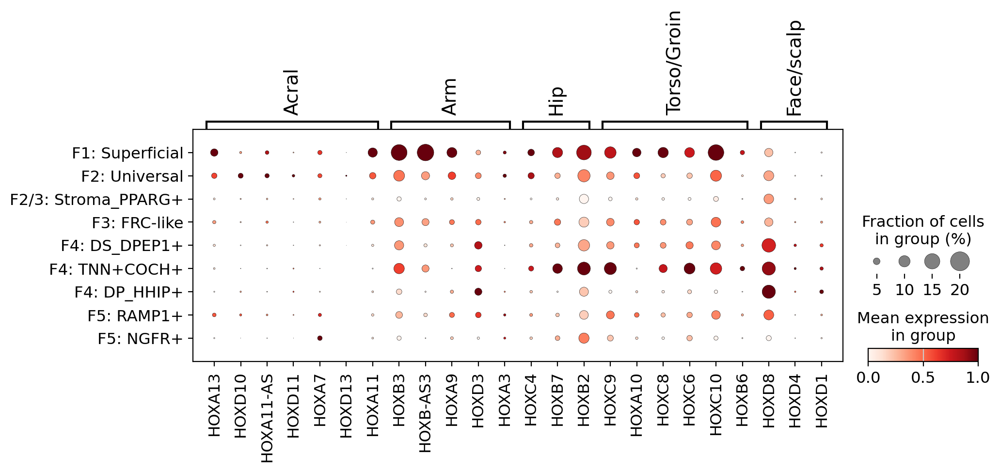

In [47]:
import pandas as pd

# Assuming you already have a DataFrame named `df`
# Here is a sample DataFrame for demonstration purposes

# Truncate the DataFrame to the first 1000 rows
df_truncated = df2.head(5000)

# Initialize an empty dictionary
result_dict = {}

# Iterate over the columns of the DataFrame
for column in df_truncated.columns:
    print(column)
    values = df_truncated[column][df_truncated[column].str.startswith("HOX", na=False)].tolist()
    result_dict[column] = values

# Display the resulting dictionary
print(result_dict)
result_dict={'Acral': ['HOXA13', 'HOXD10', 'HOXA11-AS', 'HOXD11', 'HOXA7', 'HOXD13', 'HOXA11'],
             'Arm': ['HOXB3', 'HOXD10', 'HOXB-AS3', 'HOXA9', 'HOXA11', 'HOXD3', 'HOXA13', 'HOXA3'],
             'Hip': ['HOXB3', 'HOXB-AS3', 'HOXC4', 'HOXB7', 'HOXB2', 'HOXD3'],
           'Torso/Groin': ['HOXC9', 'HOXA10', 'HOXC8', 'HOXC6', 'HOXC10', 'HOXB6',
                           #'HOXC-AS3', 'HOXC11', 'HOXB5', 'HOXC5', 'HOXB7', 'HOXB4', 'HOXB-AS3', 'HOXC-AS1', 'HOXB-AS1', 'HOXC-AS2', 'HOXA4', 'HOXA6', 'HOXA9', 'HOXC12', 'HOXA10-AS', 'HOXA5', 'HOXB8', 'HOXA11-AS'
                          ], 
             
             'Face/scalp': ['HOXD8', 'HOXD4', 'HOXD1','HOXD3']# 'HOXB-AS1'],
            }
             #'Torso': ['HOXC10', 'HOXC9', 'HOXC6', 'HOXC8', 'HOXA10', 'HOXB7', 'HOXB5', 'HOXC-AS1', 'HOXC11', 'HOXB6', 'HOXB4', 'HOXA9', 'HOXB-AS3', 'HOXA5', 'HOXC5', 'HOXB8', 'HOXC-AS3', 'HOXB9', 'HOXA4', 'HOXC-AS2', 'HOXA6', 'HOXB3', 'HOXA7', 'HOXC4', 'HOXA11', 'HOXB2', 'HOXA1', 'HOXC13', 'HOXA10-AS', 'HOXB1', 'HOXC12', 'HOXA3', 'HOXB-AS2', 'HOXA-AS3', 'HOXA-AS2', 'HOXA2', 'HOXB-AS4', 'HOXD4']}

# Create a set to track seen genes
seen_genes = set()

# Create a new dictionary where each gene appears only once
unique_result_dict = {}
for category, genes in result_dict.items():
    unique_genes = []
    for gene in genes:
        if gene not in seen_genes:
            unique_genes.append(gene)
            seen_genes.add(gene)
    unique_result_dict[category] = unique_genes

# Print the updated dictionary
sc.pl.dotplot(
    adata,
    unique_result_dict,
    groupby="Location2",
   standard_scale="var",
    dendrogram=False,
    categories_order=["Acral", "Arm", "Hip", "Torso", "Groin", "Face", "Scalp"],
)

sc.pl.dotplot(
    adata,
    unique_result_dict,
    groupby="corefb_names2",
   standard_scale="var",
    dendrogram=False,
    #categories_order=["Acral", "Arm", "Hip", "Torso", "Groin", "Face", "Scalp"],
) 
# sc.pl.dotplot(
#     adata,
#     "HOXA13",
#     groupby="test",
#    standard_scale="var",
#     dendrogram=False,
# ) 

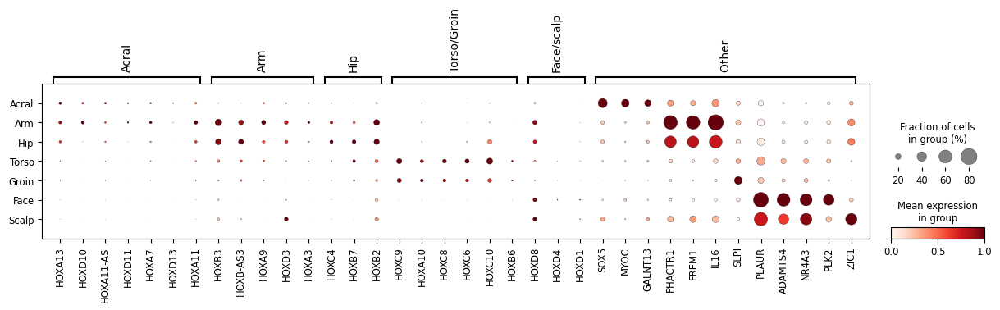

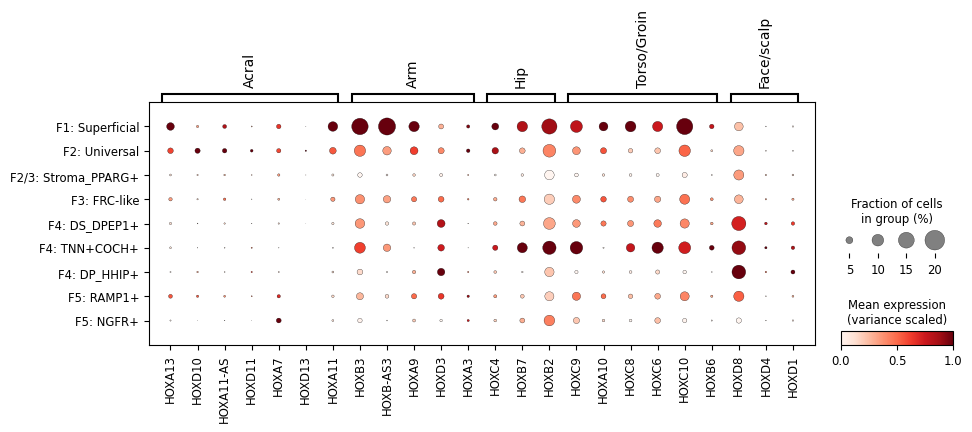

In [9]:
result_dict={'Acral': ['HOXA13', 'HOXD10', 'HOXA11-AS', 'HOXD11', 'HOXA7', 'HOXD13', 'HOXA11'],
             'Arm': ['HOXB3', 'HOXD10', 'HOXB-AS3', 'HOXA9', 'HOXA11', 'HOXD3', 'HOXA13', 'HOXA3'],
             'Hip': ['HOXB3', 'HOXB-AS3', 'HOXC4', 'HOXB7', 'HOXB2', 'HOXD3'],
           'Torso/Groin': ['HOXC9', 'HOXA10', 'HOXC8', 'HOXC6', 'HOXC10', 'HOXB6',
                           #'HOXC-AS3', 'HOXC11', 'HOXB5', 'HOXC5', 'HOXB7', 'HOXB4', 'HOXB-AS3', 'HOXC-AS1', 'HOXB-AS1', 'HOXC-AS2', 'HOXA4', 'HOXA6', 'HOXA9', 'HOXC12', 'HOXA10-AS', 'HOXA5', 'HOXB8', 'HOXA11-AS'
                          ], 
             
             'Face/scalp': ['HOXD8', 'HOXD4', 'HOXD1','HOXD3'],# 'HOXB-AS1'],
             "Other ": ["SOX5", "MYOC", "GALNT13","PHACTR1", "FREM1", "IL16", "SLPI",
                  "PLAUR", "ADAMTS4", "NR4A3", "PLK2", "ZIC1",
                 ]
            }
             #'Torso': ['HOXC10', 'HOXC9', 'HOXC6', 'HOXC8', 'HOXA10', 'HOXB7', 'HOXB5', 'HOXC-AS1', 'HOXC11', 'HOXB6', 'HOXB4', 'HOXA9', 'HOXB-AS3', 'HOXA5', 'HOXC5', 'HOXB8', 'HOXC-AS3', 'HOXB9', 'HOXA4', 'HOXC-AS2', 'HOXA6', 'HOXB3', 'HOXA7', 'HOXC4', 'HOXA11', 'HOXB2', 'HOXA1', 'HOXC13', 'HOXA10-AS', 'HOXB1', 'HOXC12', 'HOXA3', 'HOXB-AS2', 'HOXA-AS3', 'HOXA-AS2', 'HOXA2', 'HOXB-AS4', 'HOXD4']}

# Create a set to track seen genes
seen_genes = set()

# Create a new dictionary where each gene appears only once
unique_result_dict = {}
for category, genes in result_dict.items():
    unique_genes = []
    for gene in genes:
        if gene not in seen_genes:
            unique_genes.append(gene)
            seen_genes.add(gene)
    unique_result_dict[category] = unique_genes

# Print the updated dictionary
sc.pl.dotplot(
    adata,
    unique_result_dict,
    groupby="Location",
   standard_scale="var",
    dendrogram=False,
    categories_order=["Acral", "Arm", "Hip", "Torso", "Groin", "Face", "Scalp"],
)



#unique_result_dict.pop("Other", None)  # None prevents errors if the key doesn't exist

# # Alternatively, create a new dictionary without "Other"
unique_result_dict = {k: v for k, v in unique_result_dict.items() if k.strip() != "Other"}


sc.pl.dotplot(
    adata,
    unique_result_dict,
    groupby="corefb_names2",
   standard_scale="var",
    dendrogram=False,
    colorbar_title="Mean expression\n(variance scaled)",
    #categories_order=["Acral", "Arm", "Hip", "Torso", "Groin", "Face", "Scalp"],
) 
# sc.pl.dotplot(
#     adata,

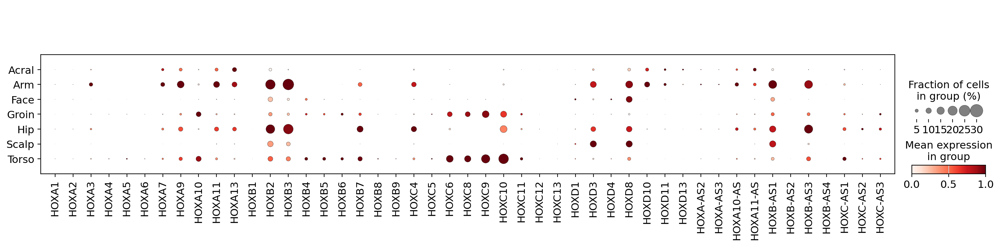

In [38]:
import re

# Flatten the dictionary values into a set to remove duplicates
unique_values = set(value for values in result_dict.values() for value in values)

# Separate genes with "AS" from the rest
non_as_genes = sorted([gene for gene in unique_values if "AS" not in gene], key=lambda x: (x[3], int(re.search(r'\d+', x).group())))
as_genes = sorted([gene for gene in unique_values if "AS" in gene], key=lambda x: (x[3], int(re.search(r'\d+', x).group())))

# Combine them with "AS" genes at the end
sorted_gene_list = non_as_genes + as_genes

 
sc.pl.dotplot(
    adata,
    sorted_gene_list,
    groupby="Location2",
   standard_scale="var",
    dendrogram=False,
) 

In [ ]:
STOP

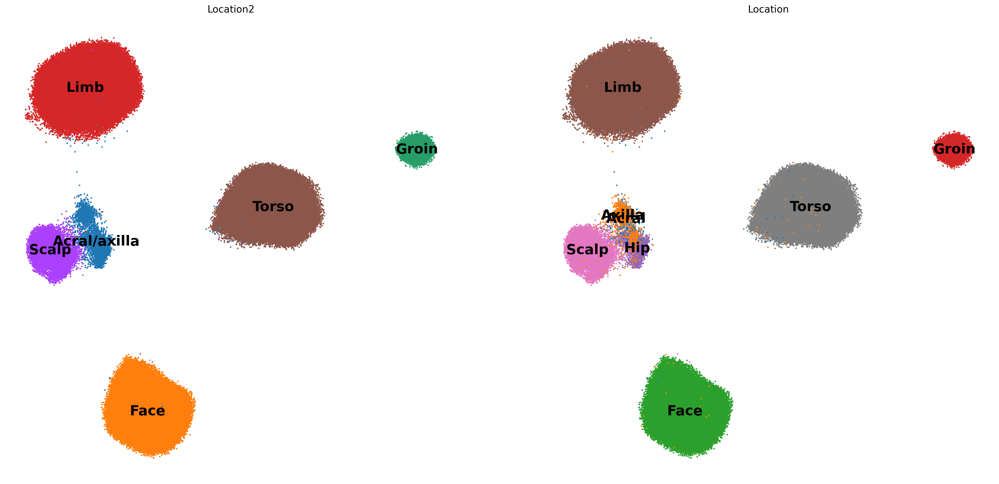

In [58]:
# new={'3': 'Groin',
#  '5': 'Torso_anterior',
#  '4': 'Arm',
#  '1':  'Torso_posterior',
#  '6':  'Acral',
#  '0': 'Face',
#  '2': 'Hip',
#  '0': 'Face',
#  '7':'Scalp',

#     }
# adata.obs["test"]=adata.obs["leiden_res0.5"].map(new)
sc.pl.umap(
        adata,
        color=["Location2", "Location"],
        ncols=len(cats), s=20,
        legend_loc="on data", legend_fontsize=20,
        frameon=False,
    )

In [ ]:
# new={'4': 'Groin',
#  '6': 'Torso_anterior',
#  '5': 'Arm',
#  '9': 'Face',
#  '11':  'Torso_posterior',
#  '7':  'Acral',
#  '0': 'Face',
#  '2': 'Hip',
#  '12': 'Face',
#  '10': 'Torso_posterior',
#  '8':'Scalp',
#  '1': 'Torso_posterior',  #'Face',
#  '3': 'Face',
#     '14': 'Torso_posterior',
#      '13': 'Face',
    
#     }
# adata.obs["test"]=adata.obs["leiden_res0.5"].map(new)
# sc.pl.umap(
#         adata,
#         color=["test", "Location"],
#         ncols=len(cats), s=20,
#         legend_loc="on data", legend_fontsize=20,
#         frameon=False,
#     )

In [ ]:
{x:x for x in adata.obs['leiden_res0.5'].unique()}

In [ ]:
# for column in df2.columns:
#     sc.pl.dotplot(
#     adata,
#     result_dict,
#     groupby="Location_detailed",
#    standard_scale="var",
#     dendrogram=False,
#     )

In [ ]:
adata[adata.obs['Location']=="Groin"].obs.dataset_id.value_counts()

Acral


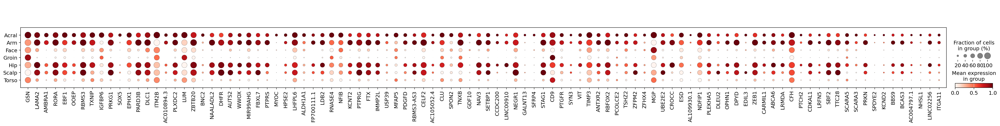

Arm


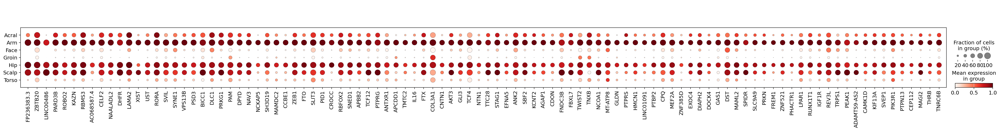

Face


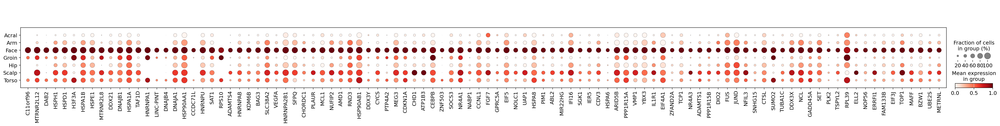

Groin


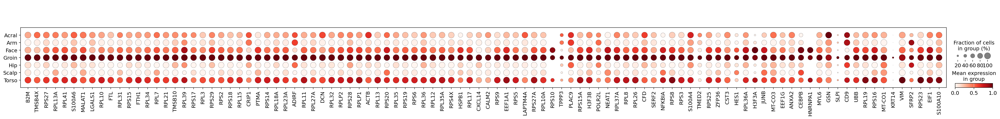

Hip


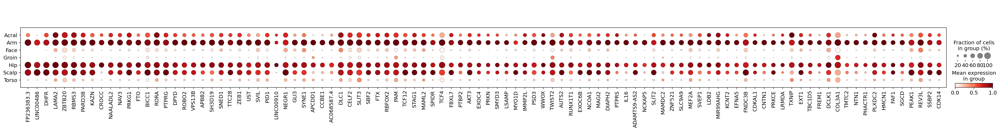

Scalp


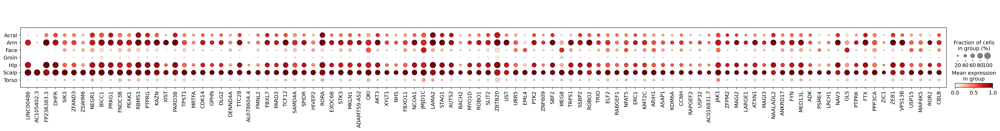

Torso


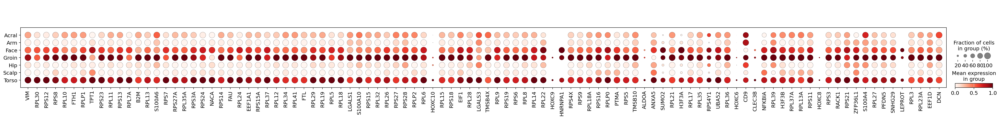

In [24]:
import pandas as pd

# Assuming you already have a DataFrame named `df`
# Here is a sample DataFrame for demonstration purposes

# Truncate the DataFrame to the first 1000 rows
df_truncated = df2.head(500)

# Initialize an empty dictionary
result_dict = {}

# Iterate over the columns of the DataFrame
for i, column in enumerate(df2.columns):
    print(column)
    select_pop = list(df2.columns)[i]
    genes0= df2[select_pop][:100]
    genes1= df2[select_pop][100:200]
    genes2= df2[select_pop][200:300]
    genes3= df2[select_pop][300:400]
    genes4= df2[select_pop][400:500]
    genes5= df2[select_pop][500:600]

    genes6= df2[select_pop][600:700]
    genes7= df2[select_pop][700:800]
    genes8= df2[select_pop][800:900]
    genes9= df2[select_pop][900:1000]
    genes10= df2[select_pop][1000:1100]
    genes11= df2[select_pop][1100:1200]
        #values = df_truncated[column][df_truncated[column].str.startswith("HOX", na=False)].tolist()
        #result_dict[column] = values

    # Display the resulting dictionary
    #print(result_dict)
    sc.pl.dotplot(
        adata,
        genes0,
        groupby="Location2",
       standard_scale="var",
        dendrogram=False,
) 
# sc.pl.dotplot(
#     adata,
#     "HOXA13",
#     groupby="test",
#    standard_scale="var",
#     dendrogram=False,
# ) 

Acral
Arm
Face
Groin
Hip
Scalp
Torso
{'Acral': ['HOXA13', 'HOXD10', 'HOXA11-AS', 'HOXD11', 'HOXA7', 'HOXD13', 'HOXA11'], 'Arm': ['HOXB3', 'HOXD10', 'HOXB-AS3', 'HOXA9', 'HOXA11', 'HOXD3', 'HOXA13', 'HOXA3'], 'Face': ['HOXD8', 'HOXD4', 'HOXD1'], 'Groin': ['HOXC9', 'HOXA10', 'HOXC8', 'HOXC6', 'HOXC10', 'HOXB6', 'HOXC-AS3', 'HOXC11', 'HOXB5', 'HOXC5', 'HOXB7', 'HOXB4', 'HOXB-AS3', 'HOXC-AS1', 'HOXB-AS1', 'HOXC-AS2', 'HOXA4', 'HOXA6', 'HOXA9', 'HOXC12', 'HOXA10-AS', 'HOXA5', 'HOXB8', 'HOXA11-AS'], 'Hip': ['HOXB3', 'HOXB-AS3', 'HOXC4', 'HOXB7', 'HOXB2', 'HOXD3'], 'Scalp': ['HOXD3', 'HOXB-AS1'], 'Torso': ['HOXC10', 'HOXC9', 'HOXC6', 'HOXC8', 'HOXA10', 'HOXB7', 'HOXB5', 'HOXC-AS1', 'HOXC11', 'HOXB6', 'HOXB4', 'HOXA9', 'HOXB-AS3', 'HOXA5', 'HOXC5', 'HOXB8', 'HOXC-AS3', 'HOXB9', 'HOXA4', 'HOXC-AS2', 'HOXA6', 'HOXB3', 'HOXA7', 'HOXC4', 'HOXA11', 'HOXB2', 'HOXA1', 'HOXC13', 'HOXA10-AS', 'HOXB1', 'HOXC12', 'HOXA3', 'HOXB-AS2', 'HOXA-AS3', 'HOXA-AS2', 'HOXA2', 'HOXB-AS4', 'HOXD4']}


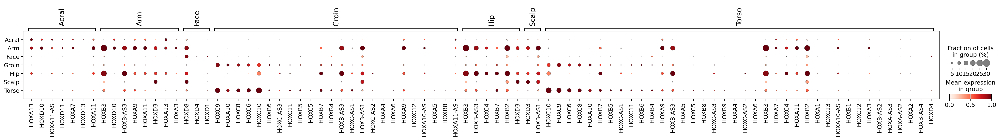

In [25]:
import pandas as pd

# Assuming you already have a DataFrame named `df`
# Here is a sample DataFrame for demonstration purposes

# Truncate the DataFrame to the first 1000 rows
df_truncated = df2.head(5000)

# Initialize an empty dictionary
result_dict = {}

# Iterate over the columns of the DataFrame
for column in df_truncated.columns:
    print(column)
    values = df_truncated[column][df_truncated[column].str.startswith("HOX", na=False)].tolist()
    result_dict[column] = values

# Display the resulting dictionary
print(result_dict)
sc.pl.dotplot(
    adata,
    result_dict,
    groupby="Location2",
   standard_scale="var",
    dendrogram=False,
) 
# sc.pl.dotplot(
#     adata,
#     "HOXA13",
#     groupby="test",
#    standard_scale="var",
#     dendrogram=False,
# ) 

In [ ]:
adata


In [ ]:
adata_test=adata[adata.obs["test"]=="Torso_anterior"]
adata_test.obs["dataset_id"].value_counts()

In [ ]:
adata_test.obs["DonorID"].value_counts()

In [ ]:
adata_test=adata[adata.obs["test"]=="Arm4"]
adata_test.obs["dataset_id"].value_counts()

In [ ]:
adata_test.obs["DonorID"].value_counts()

In [ ]:
value_to_plot="Location"

select_pop = list(df2.columns)[-1]
genes0= df2[select_pop][:100]
genes1= df2[select_pop][100:200]
genes2= df2[select_pop][200:300]
genes3= df2[select_pop][300:400]
genes4= df2[select_pop][400:500]
genes5= df2[select_pop][500:600]

genes6= df2[select_pop][600:700]
genes7= df2[select_pop][700:800]
genes8= df2[select_pop][800:900]
genes9= df2[select_pop][900:1000]
genes10= df2[select_pop][1000:1100]
genes11= df2[select_pop][1100:1200]
sc.pl.dotplot(
    adata,
    genes0,
    groupby=value_to_plot,
    standard_scale="var",
    dendrogram=False,
) 

sc.pl.dotplot(
    adata,
    genes1,
    groupby=value_to_plot,
    standard_scale="var",
    dendrogram=False,
) 

sc.pl.dotplot(
    adata,
    genes2,
    groupby=value_to_plot,
    standard_scale="var",
    dendrogram=False,
) 

# sc.pl.dotplot(
#     adata,
#     genes3,
#     groupby=value_to_plot,
#     standard_scale="var",
#     dendrogram=False,
# ) 



In [ ]:
adata.write('/nfs/team298/ls34/fibroblast_atlas/adata_fbsonly_nonlesional_dis2p_simple_mo_pr.h5ad')
adata


In [ ]:
def predict_counterfactuals(
                    self,
                    adata: AnnData,
                    cov_names: list[str],
                    cov_values: list[str],
                    cov_values_cf: list[str],
                    cats: list[str],
                    n_samples_from_source: Optional[int] = None,
                    seed: Optional[int] = 0):
        """
        Predicts counterfactuals for a given subset of data.

        This function estimates the counterfactual outcomes for a subset of data based on specified changes in covariate values.

        Parameters:
            adata (AnnData): The subset of the data for which the counterfactuals are to be predicted.
            cov_names (list[str]): Names of the covariates that are to be changed.
            cov_values (list[str]): Original values for the covariates that are to be changed.
            cov_values_cf (list[str]): Counterfactual values for the covariates that are to be changed.
            cats (list[str]): Names of the categorical covariates.
            n_samples_from_source (Optional[int], optional): Number of samples to take from the source data 
                to predict the counterfactuals. If None, all samples from the source data are used. Defaults to None.
            seed (Optional[int], optional): Random seed for reproducibility. Defaults to 0. Only used if `n_samples_from_source` is not None.

        Returns:
            Tuple[torch.Tensor, torch.Tensor, torch.Tensor]: 
                Control (source), True Counterfactuals, and Predicted Counterfactual COUNTS. (not log-transformed)
                
        Example:
        - Single covariate change: (Going from ctrl to stimulated condition in CD4 T cells)
            cats = ['cell_type', 'condition']
            cell_type_to_check = ['CD4 T',]
            cov_names = ['condition']
            cov_values = ['ctrl']
            cov_values_cf = ['stimulated']
            n_samples_from_source = 500
            x_ctrl, x_true, x_pred = pred_our_ood_avg(,
                                                    adata[(adata.obs['cell_type'].isin(cell_type_to_check))].copy(),
                                                    cov_names=cov_names,
                                                    cov_values=cov_values,
                                                    cov_values_cf=cov_values_cf,
                                                    cats=cats,
                                                    n_samples_from_source=n_samples_from_source,
                                                    )
        
        - Multiple covariate change: (Going from female breast to male prostate gland in Epithelial cell (luminal) cells)
            cats = ['tissue', 'Sample ID', 'sex', 'Age_bin', 'CoarseCellType']
            cell_type_to_check = 'Epithelial cell (luminal)'

            cov_names = ['sex', 'tissue']
            cov_values = ['female', 'breast']
            cov_values_cf = ['male', 'prostate gland']
            n_samples_from_source = None
            x_ctrl, x_true, x_pred = model.predict_counterfactuals(,
                                                    adata[adata.obs['Broad cell type'] == cell_type_to_check].copy(), # We want to do 
                                                                        # counterfactuals in the mentioned covariates, in this cell type
                                                    cov_names=cov_names,
                                                    cov_values=cov_values,
                                                    cov_values_cf=cov_values_cf,
                                                    cats=cats,
                                                    n_samples_from_source=n_samples_from_source,
                                                    )
        """

In [ ]:
sc.pl.umap(
        adata,
        color=["HOXC9", "HOXC8"],
        ncols=2, vmax=2, s=20, 
        frameon=False,
    )
sc.pl.umap(
        adata,
        color=["HOXC9", "HOXC8"],
        ncols=1, vmax=2, s=20, 
        frameon=False,
    )

In [ ]:
sc.pl.umap(
        adata,
        color=["HOXC9", "HOXC8", "HOXC10", "HOXA10"],
        ncols=2, vmax=2, s=20,
        frameon=False,
    )

In [ ]:
sc.pl.dotplot(
    adata,
    result_dict,
    groupby="Location",
   standard_scale="var",
    dendrogram=False,
) 
# sc.

In [ ]:
sc.pl.dotplot(
    adata,
    "HOXA13",
    groupby="leiden_res0.5",
   standard_scale="var",
    dendrogram=False,
) 

In [ ]:
sc.pl.umap(
        adata,
        color="Location_broad",
        ncols=len(cats),
        frameon=False,
    )

In [ ]:
location_degs = {"Acral": ['SOX5', 'COMP', 'EPDR1', 'THBS4', 'CRTAC1', 'HOXA13', 'EYA4', 'ANGPTL7','ZFHX4-AS1' ],
                 "Face": ['LINC-PINT', 'DNAJB4', 'ZNF503', 'KDELR2', 'ATP5MF', 'SPTSSA', 'HIGD2A',  
                         'IFITM1', 'ZNF503', 'Z97200.1'], 
                 "Limb": ['CAPS', 'WIF1'],
                 "Scalp": ['LINC00486', 'ZIC1', 'RNF111'],
                 "Torso": ['HOXC9', 'HOXC10', 'ARSG', 'HOXB3', 'HOXB7', 'HOXB-AS3', 'HOXC8' ]} 

In [ ]:
genes_to_plot = ['LINC-PINT', 'DNAJB4',   'SPTSSA', 'HIGD2A',  
                         'IFITM1', 'ZNF503', 'Z97200.1']
genes_avail=set(adata.var_names)
genes_to_plot = [x for x in genes_to_plot if x in genes_avail]
sc.pl.umap(
        adata,
        color=genes_to_plot,
        ncols=3, vmax=2,
        frameon=False,
    )

In [ ]:
acral= ['SOX5', 'COMP', 'THBS4', 'CRTAC1',  'ANGPTL7', ] #'EYA4', 'ZFHX4-AS1'

In [ ]:
1

In [ ]:
sc.pl.umap(
        adata,
        color=["SOX5", "CRTAC1", "COMP", "THBS4"],
        ncols=2, vmax=2,
        frameon=False,
    )

In [ ]:
sc.pl.umap(
        adata,
        color=["SOX5", "LINC-PINT", "CAPS", "HOXC10"],
        ncols=2, vmax=2, s=1,
        frameon=False,
    )

In [ ]:
sc.pl.umap(
        adata,
        color=acral,
        ncols=3, vmax=2,
        frameon=False,
    )

In [ ]:
#adata.write(adata_save_path)

# interrogate

In [ ]:
# if not adata.obs.index.equals(adata2.obs.index):
#     # Reorder adata2 indices to match adata indices
#     adata2 = adata2[adata.obs.index]
# adata.obs['lvl1_annotation'] = labels
# # adata.obs['lvl1_annotation'] = labels 

# Inspect Z

In [ ]:
file_name

In [ ]:
cats = ['sex', 'Tissue_type', 'lab', 'sample_id', 'cell_line_type', 'lvl7_annotation'] #'fine_annotation',  'lab', 


In [ ]:
for i in range(len(cats) + 1):  # loop over all Z_i

    latent_name = f'dis2p_Z_{i}'

    print(f"---UMAP for {latent_name}---")

    sc.pp.neighbors(adata, use_rep=f"{latent_name}")
    sc.tl.umap(adata)

    sc.pl.umap(
        adata,
        color=cats,
        ncols=len(cats),
        frameon=False,
    )

In [ ]:
a